In [1]:
from IPython.display import display, HTML

# Set a maximum height for all output areas
display(HTML('''<style>.output_area pre {max-height: 100px; overflow-y: scroll;}</style>'''))

In [2]:
BRANCH = 'main'

In [3]:
import os

NEMO_DIR_PATH = "NeMo"

if not os.path.exists(NEMO_DIR_PATH):
  ! git clone -b $BRANCH https://github.com/NVIDIA/NeMo
  %cd NeMo
  ! python -m pip install git+https://github.com/NVIDIA/NeMo.git@$BRANCH#egg=nemo_toolkit[all]

Cloning into 'NeMo'...
remote: Enumerating objects: 175855, done.
remote: Counting objects: 100% (23/23), done.
remote: Compressing objects: 100% (23/23), done.
remote: Total 175855 (delta 3), reused 1 (delta 0), pack-reused 175832 (from 1)
Receiving objects: 100% (175855/175855), 257.17 MiB | 62.85 MiB/s, done.
Resolving deltas: 100% (132760/132760), done.
/home/NeMo


/opt/conda/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


DEPRECATION: git+https://github.com/NVIDIA/NeMo.git@main#egg=nemo_toolkit[all] contains an egg fragment with a non-PEP 508 name pip 25.0 will enforce this behaviour change. A possible replacement is to use the req @ url syntax, and remove the egg fragment. Discussion can be found at https://github.com/pypa/pip/issues/11617
  Cloning https://github.com/NVIDIA/NeMo.git (to revision main) to /tmp/pip-install-jo20uock/nemo-toolkit_7495d9a7b5b64663b552d485a2383d08
  Running command git clone --filter=blob:none --quiet https://github.com/NVIDIA/NeMo.git /tmp/pip-install-jo20uock/nemo-toolkit_7495d9a7b5b64663b552d485a2383d08
  Resolved https://github.com/NVIDIA/NeMo.git to commit 9796b6956555d43b48819a983f582728624e4996
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadat

In [4]:
import json
import os
import wget

from IPython.display import Audio
import numpy as np
import scipy.io.wavfile as wav

! pip install pandas
! pip install plotly
from plotly import graph_objects as go

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 65.5 MB/s eta 0:00:00a 0:00:01


# 1. Introduction
End-to-end Automatic Speech Recognition (ASR) systems surpassed traditional systems in performance but require large amounts of labeled data for training.

This tutorial will show how to use a pre-trained with Connectionist Temporal Classification (CTC) ASR model, such as [QuartzNet Model](https://arxiv.org/abs/1910.10261) or [Citrinet](https://arxiv.org/abs/2104.01721) to split long audio files and the corresponding transcripts into shorter fragments that are suitable for an ASR model training.

We're going to use [ctc-segmentation](https://github.com/lumaku/ctc-segmentation) Python package based on the algorithm described in [CTC-Segmentation of Large Corpora for German End-to-end Speech Recognition](https://arxiv.org/pdf/2007.09127.pdf).

In [5]:
! pip install git+https://github.com/lumaku/ctc-segmentation
! apt-get install -y ffmpeg

  Cloning https://github.com/lumaku/ctc-segmentation to /tmp/pip-req-build-f5qsf888
  Running command git clone --filter=blob:none --quiet https://github.com/lumaku/ctc-segmentation /tmp/pip-req-build-f5qsf888
  Resolved https://github.com/lumaku/ctc-segmentation to commit a30080aadd6e606c3a74625ff31b0681fd3496bf
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached Cython-3.0.11-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.2 kB)
Using cached Cython-3.0.11-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.6 MB)
  Created wheel for ctc_segmentation: filename=ctc_segmentation-1.7.4-cp311-cp311-linux_x86_64.whl size=47447 sha256=51575ffdb2e6c162d0d07a6ca5396a719f48728d5cc6192f82b6a04a0460a339
  Stored in directory: /tmp/pip-ephem-wheel-cache-61mc9chb/wheels/ff/58/b9/a811f024425839f9ff71759098d066287b32014a4469137bfa
Successfully built ctc_segmentation
Readi

`TOOLS_DIR` contains scripts that we are going to need during the next steps, all necessary scripts could be found [here](https://github.com/NVIDIA/NeMo/tree/main/tools/ctc_segmentation/scripts).

In [6]:
if not os.path.exists(NEMO_DIR_PATH):
  NEMO_DIR_PATH = "NeMo"

%cd /home

TOOLS_DIR = f'{NEMO_DIR_PATH}/tools/ctc_segmentation/scripts'
print(TOOLS_DIR)
! ls -l $TOOLS_DIR

/opt/conda/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


/home
NeMo/tools/ctc_segmentation/scripts
total 68
-rw-r--r-- 1 root root  7889 Aug 29 11:48 cut_audio.py
-rw-r--r-- 1 root root  7931 Aug 29 11:48 get_metrics_and_filter.py
-rw-r--r-- 1 root root  1666 Aug 29 11:48 normalization_helpers.py
-rw-r--r-- 1 root root 17484 Aug 29 11:48 prepare_data.py
-rw-r--r-- 1 root root  7989 Aug 29 11:48 run_ctc_segmentation.py
-rw-r--r-- 1 root root 12848 Aug 29 11:48 utils.py
-rw-r--r-- 1 root root  3978 Aug 29 11:48 verify_segments.py


# 2. Data Download
First, let's download audio and text data (data source: [https://librivox.org/](https://librivox.org/) and [http://www.gutenberg.org](http://www.gutenberg.org).

In [7]:
## create data directory and download an audio file
WORK_DIR = '.'
DATA_DIR = WORK_DIR + '/data'
os.makedirs(DATA_DIR, exist_ok=True)

We downloaded audio and text samples in `English` and `Spanish`:

Data folder for each language contains both audio and text files. Note, the text file and the audio file share the same base name. For example, an audio file `example.wav` should have a corresponding text file called `example.txt`.

In [8]:
! ls $DATA_DIR/audio/ $DATA_DIR/text/

./data/audio/:
0.wav	11.wav	14.wav	17.wav	2.wav	22.wav	4.wav  7.wav
1.wav	12.wav	15.wav	18.wav	20.wav	23.wav	5.wav  8.wav
10.wav	13.wav	16.wav	19.wav	21.wav	3.wav	6.wav  9.wav

./data/text/:
0.txt	11.txt	14.txt	17.txt	2.txt	22.txt	4.txt  7.txt  sample.txt
1.txt	12.txt	15.txt	18.txt	20.txt	23.txt	5.txt  8.txt
10.txt	13.txt	16.txt	19.txt	21.txt	3.txt	6.txt  9.txt


# 3. Segmentation of a single file (Spanish sample)

Let's listen to our Spanish audio sample:

In [17]:
DATA_DIR = "data"

In [12]:
base_name = "sample"
! ffmpeg -i data/audio/sample.mp3 -ac 1 data/audio/sample.wav -y
# Audio(f"{DATA_DIR}/audio/{base_name}.wav")

ffmpeg version 4.3 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7.3.0 (crosstool-NG 1.23.0.449-a04d0)
  configuration: --prefix=/opt/conda/conda-bld/ffmpeg_1597178665428/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeh --cc=/opt/conda/conda-bld/ffmpeg_1597178665428/_build_env/bin/x86_64-conda_cos6-linux-gnu-cc --disable-doc --disable-openssl --enable-avresample --enable-gnutls --enable-hardcoded-tables --enable-libfreetype --enable-libopenh264 --enable-pic --enable-pthreads --enable-shared --disable-static --enable-version3 --enable-zlib --enable-libmp3lame
  libavutil      56. 51.100 / 56. 51.100
  libavcodec     58. 91.100 / 58. 91.100
  libavformat    58. 45.100 / 58. 45.100
  libavdevice    58. 10.100 / 58. 10.100
  libavfilter     7. 85.100 /  7. 85.100
  libavresample   4.  0.  0 /  4.  0.  0
  libsw

Let's take a look at the ground truth text:

In [43]:
text = f"{DATA_DIR}/text2/{2}.txt"
! cat $text

"Yes Mr; Solicitor. My Lord, I was on page 24 of my written submissions, because I left at the article written by My Lord, the then the Honourable Law Minister. Yes. Finance minister. No, that was an article written in response to certain concerns which were raised, and which was published in Press Information Bureau; It's available in public domain; My Lord, I was reading from Volume 2 at page 14; Kindly read from page 14, Volume 2; Then I'll come back to my written submissions. Page?. Page 14 of Volume 2; The title My Lord, for identifying the letter; Press Information Bureau, Government of India, Ministry of Finance; Your Lordships gets, My Lord?. Yes. Kindly come to; allow me to read the last para, because I have read till 10; I do believe, My Lord, 'I do believe that donations made online through cheques, remain an ideal method of donating to political parties; However, these have become a very popular, but this has not become very popular in India, since they involve disclosure o

As one probably noticed, the audio file contains a prologue and an epilogue that are missing in the corresponding text. The segmentation algorithm could handle extra audio fragments at the end and the beginning of the audio, but prolonged untranscribed audio segments in the middle of the file could deteriorate segmentation results. That is why, it is recommended to normalize text, so that transcripts contain spoken equivalents of abbreviations and numbers.

## 3.1. Prepare Text and Audio

We're going to use `prepare_data.py` script to prepare both text and audio data for segmentation.

### Text preprocessing:
* the text will be roughly split into sentences and stored under '$OUTPUT_DIR/processed/*.txt' where each sentence is going to start with a new line (we're going to find alignments for these sentences in the next steps)
* to change the lengths of the final sentences/fragments, specify additional punctuation marks to split the text into fragments, use `--additional_split_symbols` argument. Use `|` as a separator between symbols, for example: `--additional_split_symbols=;|:`
* `max_length` argument - max number of words in a segment for alignment (used only if there are no punctuation marks present in the original text. Long non-speech segments are better for segments split and are more likely to co-occur with punctuation marks. Random text split could deteriorate the quality of the alignment.
* out-of-vocabulary words will be removed based on pre-trained ASR model vocabulary, and the text will be changed to lowercase
* sentences for alignment with the original punctuation and capitalization will be stored under  `$OUTPUT_DIR/processed/*_with_punct.txt`
* numbers will be converted from written to their spoken form with `num2words` package. For English, it's recommended to use NeMo normalization tool use `--use_nemo_normalization` argument (not supported if running this segmentation tutorial in Colab, see the text normalization tutorial: [`tutorials/text_processing/Text_Normalization.ipynb`](https://colab.research.google.com/github/NVIDIA/NeMo/blob/stable/tutorials/text_processing/Text_Normalization.ipynb) for more details). Even `num2words` normalization is usually enough for proper segmentation. However, it does not take audio into account. NeMo supports audio-based normalization for English, German and Russian languages that can be applied to the segmented data as a post-processing step. Audio-based normalization produces multiple normalization options. For example, `901` could be normalized as `nine zero one` or `nine hundred and one`. The audio-based normalization chooses the best match among the possible normalization options and the transcript based on the character error rate. Note, the audio-based normalization of long audio samples is not supported due to multiple normalization options. See [NeMo/nemo_text_processing/text_normalization/normalize_with_audio.py](https://github.com/NVIDIA/NeMo/blob/stable/nemo_text_processing/text_normalization/normalize_with_audio.py) for more details.

### Audio preprocessing:
* non '.wav' audio files will be converted to `.wav` format
* audio files will be resampled to 16kHz (sampling rate used during training NeMo ASR models)
* stereo tracks will be converted to mono
* In some cases, if an audio contains a very long untranscribed prologue, increasing `--cut_prefix` value might help improve segmentation quality.


The `prepare_data.py` will preprocess all `.txt` files found in the `--in_text=$DATA_DIR` and all audio files located at `--audio_dir=$DATA_DIR`.

We are going to use [Spanish Citrinet-512 model](https://catalog.ngc.nvidia.com/orgs/nvidia/teams/nemo/models/stt_es_citrinet_512).

In [12]:
! pip install num2words

In [51]:
import torch
torch.cuda.empty_cache()

In [52]:
MODEL = "stt_en_citrinet_256"
OUTPUT_DIR = DATA_DIR + "/output2"

! rm -rf $OUTPUT_DIR

! python $TOOLS_DIR/prepare_data.py \
--in_text=$DATA_DIR/text2 \
--output_dir=$OUTPUT_DIR/processed/ \
--language='en' \
--model=$MODEL \
--audio_dir=$DATA_DIR/audio2 \
--additional_split_symbols=\; \
--use_nemo_normalization

[NeMo I 2024-08-29 10:48:15 nemo_logging:381] Downloading from: https://api.ngc.nvidia.com/v2/models/nvidia/nemo/stt_en_citrinet_256/versions/1.0.0rc1/files/stt_en_citrinet_256.nemo to /root/.cache/torch/NeMo/NeMo_2.0.0rc2/stt_en_citrinet_256/91a9cc5850784b2065e8a0aa3d526fd9/stt_en_citrinet_256.nemo
100% [....................................................] 38872168 / 38872168[NeMo I 2024-08-29 10:48:20 nemo_logging:381] Instantiating model from pre-trained checkpoint
[NeMo I 2024-08-29 10:48:21 nemo_logging:381] Tokenizer SentencePieceTokenizer initialized with 1024 tokens
[NeMo W 2024-08-29 10:48:21 nemo_logging:393] If you intend to do training or fine-tuning, please call the ModelPT.setup_training_data() method and provide a valid configuration file to setup the train data loader.
    Train config : 
    manifest_filepath: null
    sample_rate: 16000
    batch_size: 32
    trim_silence: true
    max_duration: 16.7
    shuffle: true
    is_tarred: false
    tarred_audio_filepaths: 

The following four files should be generated and stored at the `$OUTPUT_DIR/processed` folder:

* el19demarzoyel2demayo_03_perezgaldos.txt (lower cased and normalized text with punctuation removed, each line represents an utterance for alignment)
* el19demarzoyel2demayo_03_perezgaldos.wav (.wav mono file, 16kHz)
* el19demarzoyel2demayo_03_perezgaldos_with_punct.txt  (raw utterances for alignment with punctuation and case preserved)
* el19demarzoyel2demayo_03_perezgaldos_with_punct_normalized.txt (normalized utterances for alignment utterance for alignment with punctuation and case preserved)

In [41]:
! ls $OUTPUT_DIR/processed

2.txt  2.wav  2_with_punct.txt	2_with_punct_normalized.txt  en_grammars


The `.txt` file without punctuation contains preprocessed text phrases that we're going to align within the audio file. Here, we split the text into sentences. Each line should contain a text snippet for alignment.

In [53]:
! head $OUTPUT_DIR/processed/2.txt

"yes mr;
solicitor.
my lord, i was on page twenty four of my written submissions, because i left at the article written by my lord, the then the honourable law minister.
yes.
finance minister.
no, that was an article written in response to certain concerns which were raised, and which was published in press information bureau;
it's available in public domain;
my lord, i was reading from volume two at page fourteen;
kindly read from page fourteen, volume two;
then i'll come back to my written submissions.


## 3.2. Run CTC-Segmentation

In this step, we're going to use the [`ctc-segmentation`](https://github.com/lumaku/ctc-segmentation) to find the start and end time stamps for the segments we created during the previous step.


As described in the [CTC-Segmentation of Large Corpora for German End-to-end Speech Recognition](https://arxiv.org/pdf/2007.09127.pdf), the algorithm is relying on a CTC-based ASR model to extract utterance segments with exact time-wise alignments.

In [54]:
WINDOW = 8000

! python $TOOLS_DIR/run_ctc_segmentation.py \
--output_dir=$OUTPUT_DIR \
--data=$OUTPUT_DIR/processed \
--model=$MODEL \
--window_len=$WINDOW

[NeMo I 2024-08-29 10:58:00 nemo_logging:381] Found existing object /root/.cache/torch/NeMo/NeMo_2.0.0rc2/stt_en_citrinet_256/91a9cc5850784b2065e8a0aa3d526fd9/stt_en_citrinet_256.nemo.
[NeMo I 2024-08-29 10:58:00 nemo_logging:381] Re-using file from: /root/.cache/torch/NeMo/NeMo_2.0.0rc2/stt_en_citrinet_256/91a9cc5850784b2065e8a0aa3d526fd9/stt_en_citrinet_256.nemo
[NeMo I 2024-08-29 10:58:00 nemo_logging:381] Instantiating model from pre-trained checkpoint
[NeMo I 2024-08-29 10:58:01 nemo_logging:381] Tokenizer SentencePieceTokenizer initialized with 1024 tokens
[NeMo W 2024-08-29 10:58:01 nemo_logging:393] If you intend to do training or fine-tuning, please call the ModelPT.setup_training_data() method and provide a valid configuration file to setup the train data loader.
    Train config : 
    manifest_filepath: null
    sample_rate: 16000
    batch_size: 32
    trim_silence: true
    max_duration: 16.7
    shuffle: true
    is_tarred: false
    tarred_audio_filepaths: null
    use_

`WINDOW` parameter might need to be adjusted depending on the length of the utterance one wants to align, the default value should work in most cases. By default, if the alignment is not found for the initial `WINDOW` size, the window size will be doubled a few times to re-try backtracing.

Let's take a look at the generated alignments.

In [21]:
alignment_file = f"{WINDOW}_{base_name}_segments.txt"
! head -n 3 $OUTPUT_DIR/segments/$alignment_file

data/output/processed/sample.wav
31.199153931532987 33.37910837400015 -1.7042021220205006 | there's a note | There's a note. | There's a note.
35.839028105966094 38.338973870807955 -0.03207129241185764 | yes let's have a quick | Yes, let's have a quick; | Yes, let's have a quick;


The expected output for our audio sample looks like this:

```
<PATH_TO>/processed/el19demarzoyel2demayo_03_perezgaldos.wav
11.518331881862931 25.916246734191596 -1.2629864680237006 | entraron en la habitación donde estábamos y al punto que d mauro vio a su sobrina dirigiose a ella con los brazos abiertos y al estrecharla en ellos exclamó endulzando la voz ¡inés de mi alma inocente hija de mi prima juana | Entraron en la habitación donde estábamos, y al punto que D.  Mauro vio a su sobrina dirigiose a ella con los brazos abiertos, y al estrecharla en ellos, exclamó endulzando la voz: -¡Inés de mi alma, inocente hija de mi prima Juana! | Entraron en la habitación donde estábamos, y al punto que D.  Mauro vio a su sobrina dirigiose a ella con los brazos abiertos, y al estrecharla en ellos, exclamó endulzando la voz: - Inés de mi alma, inocente hija de mi prima Juana!
25.756269902499053 28.155922377887165 -0.0003830735786323203 | al fin al fin te veo | Al fin, al fin te veo. | Al fin, al fin te veo.
...
```

**Details of the file content**:
- the first line of the file contains the path to the original audio file
- all subsequent lines contain:
  * the first number is the start of the segment (in seconds)
  * the second one is the end of the segment (in seconds)
  * the third value - alignment confidence score (in log space)
  * text fragments corresponding to the timestamps
  * original text without pre-processing
  * normalized text

Finally, we're going to split the original audio file into segments based on the found alignments. We're going to save only segments with alignment score above the threshold value (default threshold=-2:
* high scored clips (segments with the segmentation score above the threshold value)
* low scored clips (segments with the segmentation score below the threshold)
* deleted segments (segments that were excluded during the alignment. For example, in our sample audio file, the prologue and epilogue that don't have the corresponding transcript were excluded. Oftentimes, deleted files also contain such things as clapping, music, or hard breathing.

The alignment score values depend on the pre-trained model quality and the dataset.

Also note, that the `OFFSET` parameter is something one might want to experiment with since timestamps have a delay (offset) depending on the model.


In [57]:
OFFSET = 0
THRESHOLD = -3

! python $TOOLS_DIR/cut_audio.py \
--output_dir=$OUTPUT_DIR \
--alignment=$OUTPUT_DIR/segments/ \
--threshold=$THRESHOLD \
--offset=$OFFSET

Splitting audio files into segments...
100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  1.73it/s]
Original duration  : 331min
High score segments: 106min (32%)
Low score segments : 51min (15%)
Deleted segments   : 172min (52%)
Stats saved at /home/data/output2/stats.tsv
Manifest saved at /home/data/output2/manifests/manifest.json


## 3.3. Transcribe segmented audio

The transcripts will be saved in a new manifest file in `pred_text` field.

In [59]:
# wget.download(f'https://raw.githubusercontent.com/NVIDIA/NeMo/{BRANCH}/examples/asr/transcribe_speech.py')

! python transcribe_speech.py \
pretrained_name=$MODEL \
dataset_manifest=$OUTPUT_DIR/manifests/manifest.json \
output_filename=$OUTPUT_DIR/manifests/manifest_transcribed.json

[NeMo W 2024-08-29 11:00:00 nemo_logging:393] /opt/conda/lib/python3.11/site-packages/hydra/_internal/hydra.py:119: UserWarning: Future Hydra versions will no longer change working directory at job runtime by default.
    See https://hydra.cc/docs/1.2/upgrades/1.1_to_1.2/changes_to_job_working_dir/ for more information.
      ret = run_job(
    
[NeMo I 2024-08-29 11:00:00 nemo_logging:381] Hydra config: model_path: null
    pretrained_name: stt_en_citrinet_256
    audio_dir: null
    dataset_manifest: data/output2/manifests/manifest.json
    channel_selector: null
    audio_key: audio_filepath
    eval_config_yaml: null
    presort_manifest: true
    output_filename: data/output2/manifests/manifest_transcribed.json
    batch_size: 32
    num_workers: 0
    append_pred: false
    pred_name_postfix: null
    random_seed: null
    compute_timestamps: false
    preserve_alignment: false
    compute_langs: false
    cuda: null
    allow_mps: false
    amp: false
    amp_dtype: float16
    

In [60]:
def plot_signal(signal, sample_rate):
    """ Plot the signal in time domain """
    fig_signal = go.Figure(
        go.Scatter(x=np.arange(signal.shape[0])/sample_rate,
                   y=signal, line={'color': 'green'},
                   name='Waveform',
                   hovertemplate='Time: %{x:.2f} s<br>Amplitude: %{y:.2f}<br><extra></extra>'),
        layout={
            'height': 200,
            'xaxis': {'title': 'Time, s'},
            'yaxis': {'title': 'Amplitude'},
            'title': 'Audio Signal',
            'margin': dict(l=0, r=0, t=40, b=0, pad=0),
        }
    )
    fig_signal.show()

def display_samples(manifest):
    """ Display audio and reference text."""
    with open(manifest, 'r') as f:
        for line in f:
            sample = json.loads(line)
            sample_rate, signal = wav.read(sample['audio_filepath'])
            plot_signal(signal, sample_rate)
            display(Audio(sample['audio_filepath']))
            display('Reference text:       ' + sample['text_no_preprocessing'])
            if 'pred_text' in sample:
                display('ASR transcript: ' + sample['pred_text'])
            print(f"Score: {sample['score']}")
            print('\n' + '-' * 110)

Let's examine the high scored segments we obtained.

The `Reference text` in the next cell represents the original text without pre-processing, while `ASR transcript` is an ASR model prediction with greedy decoding. Also notice, that `ASR transcript` in some cases contains errors that could decrease the alignment score, but usually it doesn’t hurt the quality of the aligned segments.

Displaying audio in Jupyter Notebook could be slow, it's recommended to use [Speech Data Explorer](https://docs.nvidia.com/deeplearning/nemo/user-guide/docs/en/stable/tools/speech_data_explorer.html) to analyze speech data.

In [61]:
# let's examine only a few first samples
! shuf -n 5 $OUTPUT_DIR/manifests/manifest_transcribed.json > $OUTPUT_DIR/manifests/samples.json

display_samples(f"{OUTPUT_DIR}/manifests/samples.json")

'Reference text:       You have a task on hand, namely the choice of a candidate;'

'ASR transcript: you have it tak can handled the choice of a candidate.'

Score: -1.22

--------------------------------------------------------------------------------------------------------------


'Reference text:       incumbent bias as large amounts of money go to the ruling party;'

'ASR transcript: incumbent buyers as a large amount of money go to the ruling party'

Score: -0.35

--------------------------------------------------------------------------------------------------------------


'Reference text:       My Lords, they may not want to take the exemption also.'

'ASR transcript: wells they may not want to take the exmpion also?'

Score: -2.55

--------------------------------------------------------------------------------------------------------------


'Reference text:       These are My Lord the objects.'

'ASR transcript: deep objects'

Score: -1.48

--------------------------------------------------------------------------------------------------------------


'Reference text:       That issue has not been addressed.'

'ASR transcript: thats issue is not being addressed'

Score: -0.68

--------------------------------------------------------------------------------------------------------------


# 4. Processing of multiple files (English samples)

Up until now, we were processing only one file at a time, but to create a large dataset processing of multiple files simultaneously could help speed up things considerably.

Our English data folder contains 2 audio files and corresponding text files:

In [9]:
! ls $DATA_DIR/audio $DATA_DIR/text

./data/audio:
0.wav	11.wav	14.wav	17.wav	2.wav	22.wav	4.wav  7.wav
1.wav	12.wav	15.wav	18.wav	20.wav	23.wav	5.wav  8.wav
10.wav	13.wav	16.wav	19.wav	21.wav	3.wav	6.wav  9.wav

./data/text:
0.txt	11.txt	14.txt	17.txt	2.txt	22.txt	4.txt  7.txt  sample.txt
1.txt	12.txt	15.txt	18.txt	20.txt	23.txt	5.txt  8.txt
10.txt	13.txt	16.txt	19.txt	21.txt	3.txt	6.txt  9.txt


We are going to use `run_segmentation.sh` to perform all the above steps starting from the text and audio preprocessing to segmentation and manifest creation in a single step:

`run_segmentation.sh` script takes `DATA_DIR` argument and assumes that it contains folders `text` and `audio`.
An example of the `DATA_DIR` folder structure:


--DATA_DIR

     |----audio
            |---1.mp3
            |---2.mp3
            
     |-----text
            |---1.txt
            |---2.txt

`run_segmentation.sh` could use multiple `WINDOW` sizes for segmentation, and then adds segments that were similarly aligned with various window sizes to `verified_segments` folder. This could be useful to reduce the amount of manual work while checking the alignment quality.

In [15]:
import torch
torch.cuda.empty_cache()

In [17]:
MODEL = "stt_en_citrinet_512_gamma_0_25" # "stt_en_citrinet_512_gamma_0_25"
OUTPUT_DIR_2 = DATA_DIR + "/output"
THRESHOLD = -3

! rm -rf $OUTPUT_DIR_2

! bash $TOOLS_DIR/../run_segmentation.sh \
--MODEL_NAME_OR_PATH=$MODEL \
--DATA_DIR=$DATA_DIR \
--OUTPUT_DIR=$OUTPUT_DIR_2 \
--SCRIPTS_DIR=$TOOLS_DIR \
--MIN_SCORE=$THRESHOLD  \
--USE_NEMO_NORMALIZATION=True

MODEL_NAME_OR_PATH = stt_en_citrinet_512_gamma_0_25
DATA_DIR = ./data
OUTPUT_DIR = ./data/output
MIN_SCORE = -3
CUT_PREFIX = 0
SCRIPTS_DIR = NeMo/tools/ctc_segmentation/scripts
OFFSET = 0
LANGUAGE = en
MIN_SEGMENT_LEN = 
MAX_SEGMENT_LEN = 30
SAMPLE_RATE = 16000
ADDITIONAL_SPLIT_SYMBOLS = :|;
USE_NEMO_NORMALIZATION = True
TEXT AND AUDIO PREPROCESSING...
[NeMo I 2024-08-29 13:09:52 nemo_logging:381] Found existing object /root/.cache/torch/NeMo/NeMo_2.0.0rc2/stt_en_citrinet_512_gamma_0_25/1497f738f22b48b92849481b7b5100e4/stt_en_citrinet_512_gamma_0_25.nemo.
[NeMo I 2024-08-29 13:09:52 nemo_logging:381] Re-using file from: /root/.cache/torch/NeMo/NeMo_2.0.0rc2/stt_en_citrinet_512_gamma_0_25/1497f738f22b48b92849481b7b5100e4/stt_en_citrinet_512_gamma_0_25.nemo
[NeMo I 2024-08-29 13:09:52 nemo_logging:381] Instantiating model from pre-trained checkpoint
[NeMo I 2024-08-29 13:09:54 nemo_logging:381] Tokenizer SentencePieceTokenizer initialized with 1024 tokens
[NeMo W 2024-08-29 13:09:55 nemo

Manifest file with segments with alignment score above the threshold values are saved in `en/output/manifests/manifest.json`.

Next, we are going to run `run_filter.sh`. The script does the following:
* adds ASR transcripts to the manifest
* calculates and saves metrics such as Word Error Rate (WER), Character Error Rate (CER), CER at the tails of the audio file, word difference between reference and transcript, mean absolute values at the tails of the audio.
* filters out samples that do not satisfy threshold values and saves selected segments in `manifest_transcribed_metrics_filtered.json`.

Note, it's better to analyze the manifest with metrics in Speech Data Explorer to decide on what thresholds should be used for final sample selection.

In [34]:
! bash $TOOLS_DIR/../run_filter.sh \
--SCRIPTS_DIR=$TOOLS_DIR \
--MODEL_NAME_OR_PATH=stt_en_citrinet_1024_gamma_0_25 \
--MANIFEST=$OUTPUT_DIR_2/manifests/manifest.json \
--INPUT_AUDIO_DIR=$DATA_DIR/audio/

--- Adding transcripts to data/output_2/manifests/manifest.json using stt_en_citrinet_512_gamma_0_25 ---
[NeMo W 2024-08-28 20:25:15 nemo_logging:393] /opt/conda/lib/python3.11/site-packages/hydra/_internal/hydra.py:119: UserWarning: Future Hydra versions will no longer change working directory at job runtime by default.
    See https://hydra.cc/docs/1.2/upgrades/1.1_to_1.2/changes_to_job_working_dir/ for more information.
      ret = run_job(
    
[NeMo I 2024-08-28 20:25:15 nemo_logging:381] Hydra config: model_path: null
    pretrained_name: stt_en_citrinet_512_gamma_0_25
    audio_dir: null
    dataset_manifest: data/output_2/manifests/manifest.json
    channel_selector: null
    audio_key: audio_filepath
    eval_config_yaml: null
    presort_manifest: true
    output_filename: data/output_2/manifests/manifest_transcribed.json
    batch_size: 4
    num_workers: 0
    append_pred: false
    pred_name_postfix: null
    random_seed: null
    compute_timestamps: false
    preserve_ali

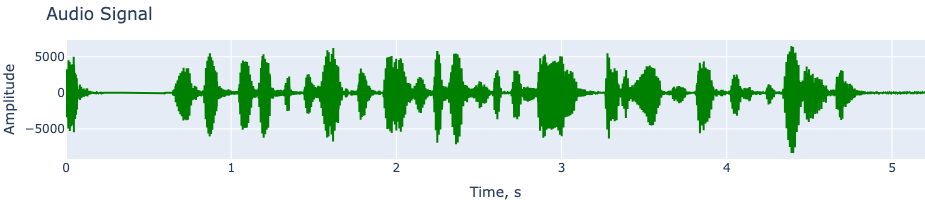

"Reference text:       We'll just say that this is the exercise which the Government of India is carrying out in pursuance of our order;"

"ASR transcript: we'll just say that this is the exercise that the government of india is carrying out in pursuits of our order"

Score: -0.63

--------------------------------------------------------------------------------------------------------------


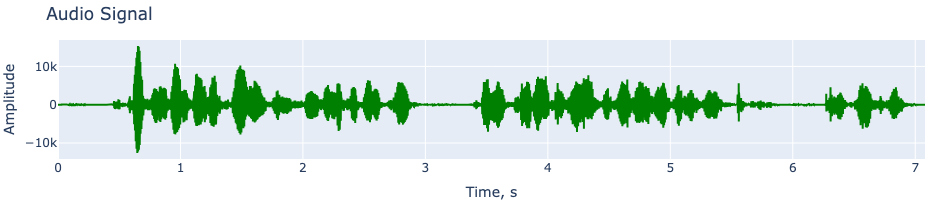

'Reference text:       Discussions entailed, examination of the issues and the potential solution thereof with the office of various divisions, sections of this Ministry;'

'ASR transcript: discussions ta examines the issues and the potential solution derob the officer aiouss division section of its ministry'

Score: -1.9

--------------------------------------------------------------------------------------------------------------


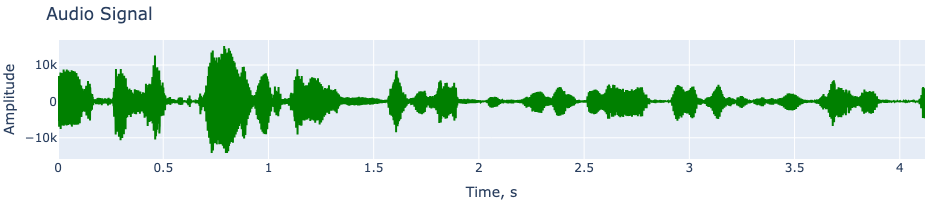

'Reference text:       The longer the time that elapses, we will be ourselves a little hazier with;'

'ASR transcript: the lastwhere the time that elapses we will be ourselves a little hazer with'

Score: -0.34

--------------------------------------------------------------------------------------------------------------


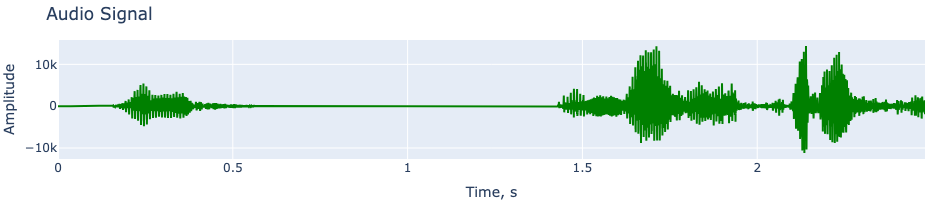

'Reference text:       will engage in expedition.'

'ASR transcript: will engage in expedition'

Score: -0.08

--------------------------------------------------------------------------------------------------------------


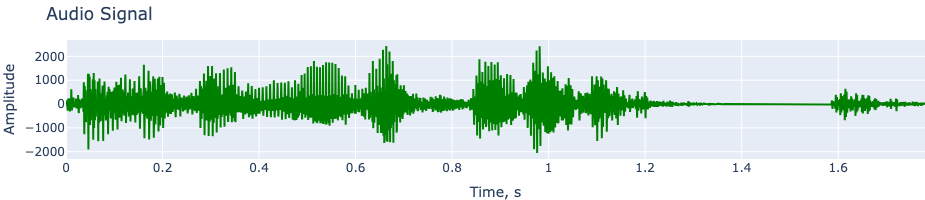

"Reference text:       We don't know what they will do."

"ASR transcript: we don't know what they will do"

Score: -0.04

--------------------------------------------------------------------------------------------------------------


In [36]:
# let's examine only a few first samples
! shuf -n 5 $OUTPUT_DIR_2/manifests/manifest_transcribed_metrics_filtered.json > $OUTPUT_DIR_2/manifests/samples.json

display_samples(f"{OUTPUT_DIR_2}/manifests/samples.json")

# Next Steps

- Check out [NeMo Speech Data Explorer tool](https://github.com/NVIDIA/NeMo/tree/main/tools/speech_data_explorer#speech-data-explorer) to interactively evaluate the aligned segments.
- Try Audio-based normalization tool.

# References
Kürzinger, Ludwig, et al. ["CTC-Segmentation of Large Corpora for German End-to-End Speech Recognition."](https://arxiv.org/abs/2007.09127) International Conference on Speech and Computer. Springer, Cham, 2020.